## TensorFlow fundamentals:
https://www.tensorflow.org/guide/basics?hl=pl

In [1]:
try:
  %tensorflow_version 2.x
except Exception:
  print("Unable to load tensforFlow 2.x")

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


## 🐶 End-to-end Multil-class Dog Breed Classification
This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.x and TensorFlow Hub.

1. Problem
Identifying the breed of a dog given an image of a dog.

When I'm sitting at the cafe and I take a photo of a dog, I want to know what breed of dog it is.

2. Data
The data we're using is from Kaggle's dog breed identification competition.

https://www.kaggle.com/c/dog-breed-identification/data

3. Evaluation
The evaluation is a file with prediction probabilities for each dog breed of each test image.

https://www.kaggle.com/c/dog-breed-identification/overview/evaluation

4. Features
Some information about the data:

* We're dealing with images (unstructured data) so it's probably best we use deep learning/transfer learning.
* There are 120 breeds of dogs (this means there are 120 different classes).
* There are around 10,000+ images in the training set (these images have labels).
* There are around 10,000+ images in the test set (these images have no labels, because we'll want to predict them).

## Get our workspace ready

1. Import tensorflow 2.x ✅
2. Import tensorflow_hub ✅
3. Make sure we are using GPU (graphical processing unit) ✅

We need to assure that we are using GPU beacuse we are dealing with unstructured data (often times the patterns are a lot more vast), so when we are running `Neural Network` it takes a lot more compute power than `traditional` learning model (random forests itp...).

In [2]:
# Import necessary liblaries
import tensorflow as tf
import tensorflow_hub as hub

print(f"TensorFlow Version {tf.__version__}")
print(f"TensorFlow Hub Version {hub.__version__}")
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

TensorFlow Version 2.12.0
TensorFlow Hub Version 0.13.0
GPU available


In [3]:
# Import standard liblaries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [4]:
# !unzip "drive/MyDrive/DogVision/dog-breed-identification.zip" -d "drive/MyDrive/DogVision/"

In [5]:
labels_csv = pd.read_csv('/content/drive/MyDrive/DogVision/labels.csv')
labels_csv.head(), len(labels_csv), labels_csv.info(), labels_csv.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10222 entries, 0 to 10221
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      10222 non-null  object
 1   breed   10222 non-null  object
dtypes: object(2)
memory usage: 159.8+ KB


(                                 id             breed
 0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
 1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
 2  001cdf01b096e06d78e9e5112d419397          pekinese
 3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
 4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever,
 10222,
 None,
                                       id               breed
 count                              10222               10222
 unique                             10222                 120
 top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
 freq                                   1                 126)

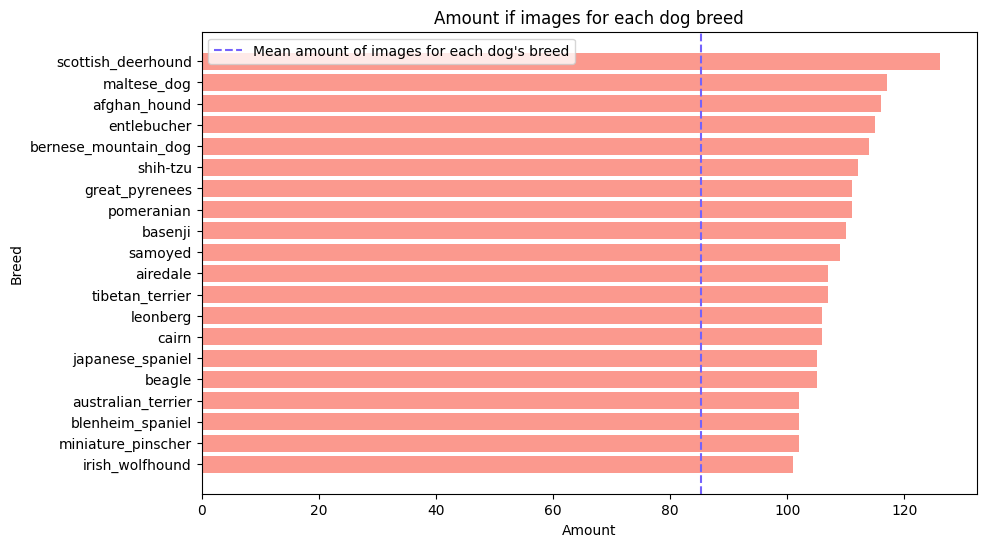

In [6]:
# Create helper function to vizualise how many images we have for each dog breed

def visualise_counts(labels, n):
  """
  Create horizontal bar plot that vizalise how many images we have in our data for each dog breed
  """
  labels_copy = labels.copy()
  labels_copy.drop(columns=["id"], inplace=True)
  counts = (pd.DataFrame(labels_copy.value_counts(), columns=["Amount if images for each dog breed"])
      .reset_index(drop=False)
      .sort_values(by="Amount if images for each dog breed", ascending=False))

  fig, ax = plt.subplots(figsize=(10, 6))

  ax.barh(counts["breed"][:n], counts["Amount if images for each dog breed"][:n], color=["salmon"], alpha=0.8)

  # Set title and labels
  ax.set(title="Amount if images for each dog breed", xlabel="Amount", ylabel="Breed")

  # Invert y-axis
  ax.invert_yaxis()

  # Set vertical line
  plt.axvline(x=counts["Amount if images for each dog breed"].mean(), linestyle='--', color="#7462fc", label="Mean amount of images for each dog's breed")

  # Set legend
  ax.legend()

visualise_counts(labels_csv, 20)

## Getting list of all our image file pathnames.

In [9]:
# Create pathnames from images ID's
filepaths = [f"drive/MyDrive/DogVision/train/{fname}.jpg" for fname in labels_csv["id"]]

# Check first ten filepaths
filepaths[:10]

['drive/MyDrive/DogVision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/DogVision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/DogVision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/DogVision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/DogVision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/DogVision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/DogVision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/DogVision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/DogVision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/DogVision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [10]:
# Check if number of filenames matches number of actual image files
import os

if len(os.listdir("/content/drive/MyDrive/DogVision/train")) == len(filepaths):
  print("Have the same lengths:", len(filepaths))
else:
  print("Don't have the same lengths.")


Have the same lengths: 10222


## Preparing labels

Since we have now got our training image filepaths in a list, let's prepare our labels.

In [11]:
# turn labels into numpy array
labels = labels_csv["breed"].to_numpy()
labels, len(labels)

(array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
        'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object),
 10222)

In [12]:
# See if label of labels matches the number of ilenames
if len(labels) == len(filepaths):
  print("Number of labels matches number of filepaths")
else:
  print("Number of labels don't match number of filepaths")

Number of labels matches number of filepaths


In [13]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [14]:
# Turn a single label into an array of booleans
print(labels[0])
labels [0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [15]:
# Turn every label into boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[0], len(boolean_labels)

(array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 10222)

In [16]:
print(labels[0])
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # Index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # There will be a 1 where sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


## Creating our own validation set

Since the dataset from Kaggle doesn't come with a validation set we are going co create our own.

In [17]:
# Setup X(features) and y(labels) variables
X = filepaths
y = boolean_labels

In [18]:
len(filepaths)

10222

We are going start off experimenting with 1000 images and increase that number as needed.

In [19]:
# Set number if images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [20]:
# Split our data into train and validation sets
from sklearn.model_selection import train_test_split

# Split into training and validation of total size NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(
                                                  X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  shuffle=True,
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(X_val), len(y_train), len(y_val)

(800, 200, 800, 200)

In [21]:
# Let's have a look at the training data
X_train[:2], y_train[:2]

(['drive/MyDrive/DogVision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/DogVision/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False

## Preprocessing Images (turning images into tensors)

Tensors are numerical representations of our data.

To preprocess our images into `Tensors` we are going to write a function that does few things:

1. Take an image filepath as an input
2. Use TensorFlow to read file and save it to a variable, `image`
3. Turn our `image` (a jpg) into `Tensors`
4. Normalize our image (convert color channel values from 0 to 255 to 0 to 1
5. Resize the `image` to be a shape of (224x224)
6. Return the modified image

Before we do, let's see what importing an image looks like.

In [22]:
# Convert image to numpy array
from matplotlib.pyplot import imread # imread stands for image-read
image = imread(filepaths[20])
image.shape # height, width, color-channel

(375, 500, 3)

In [23]:
tf.constant(image)[:2] # Now we are able to run this on GPU (so we can make computational operations faster)

<tf.Tensor: shape=(2, 500, 3), dtype=uint8, numpy=
array([[[127, 128, 120],
        [123, 124, 116],
        [117, 120, 111],
        ...,
        [ 98, 123,  65],
        [ 97, 122,  64],
        [102, 127,  69]],

       [[117, 120, 111],
        [114, 117, 108],
        [112, 115, 106],
        ...,
        [ 97, 122,  64],
        [ 94, 119,  61],
        [ 98, 123,  65]]], dtype=uint8)>

Now we have seen what an image look like as a Tensor, let's make a function to preprocess them.

In [24]:
# Define image size
IMAGE_SIZE = 224 # Shape is very important beacuse we have to fit data in the same format and shape to our machine learning model as it was trained on.

# Create a function for preprocessing images
def process_image(image_path, img_size=IMAGE_SIZE):
  """
  Takes an image path and turns the image into a Tensor.
  """

  # Read an image file
  image = tf.io.read_file(image_path)

  # Turn the jpeg image into numerical Tensor with 3 color channels (Read, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)

  # Convert the channel color values from 0 to 255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)

  # Resize the image to the desired value (224, 224)
  image = tf.image.resize(image, size=[img_size, img_size])

  return image

## Turning our data into `batches`

Why turn data into batches?



Let's say we are trying to process 10,000+ images in one go. They all might not fit into memory.

So that's why we do about 32 images (this is batch size) at a time (we can manually adjust batch size if we need).

In order to use TensorFlow effectively we need our data in the form of Tensor tuples which looks like this:
`(image, label)`.

In [25]:
# Create a simple function that returns a tuple (image, label)
def get_image_label(image_path, label):
  image = process_image(image_path)
  return image, label

In [26]:
# Demo of the above
(process_image(X[42])[:2], y[42])

(<tf.Tensor: shape=(2, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]]], dtype=float32)>,
 array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
         True, False, False, False, False, False

Now we've got a way to turn our data into tuples of Tensors in the form: `(image, label)`, let's make a function to turn all of our data (`X` and `y`) into batches.

In [27]:
# Define the batch size
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Create batches of data out of image (X) and label (y) pairs.
  Shuffle the data if it's training data but doesn't shuffle if it's validation data.
  Also accetps test data as input (no labels).
  """
  # If data is test dataset we definietly don't have test labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # Only filepaths, no labels
    data_batch = data.map(process_image).batch(batch_size)

    return data_batch

  # If data is valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # Filepaths
                                               tf.constant(y))) # Labels

    print("tensorflow.data.Dataset : ", data)
    data_batch = data.map(get_image_label).batch(batch_size)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    data = data.map(get_image_label)

    data_batch = data.batch(batch_size)

  return data_batch

In [28]:
# Create training and validation batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...
tensorflow.data.Dataset :  <_TensorSliceDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(120,), dtype=tf.bool, name=None))>


In [29]:
# Check different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualising data batches

Our data is now in batches, however these can be a little hard to understand/comprehend, let's visualise them.

In [30]:
# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a databatch.
  """
  # Setup the figure
  fig = plt.figure(figsize=(10, 10))
  # Loop through 25 to display 25 images
  for i in range(25):
    # Create subplots, 5 rows, 5 columns
    ax = fig.add_subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis("off")

In [31]:
# When we want to loop through our batches we have to use batch_data.as_numpy_iterator()
train_images, train_labels = next(train_data.as_numpy_iterator())

In [32]:
train_labels

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

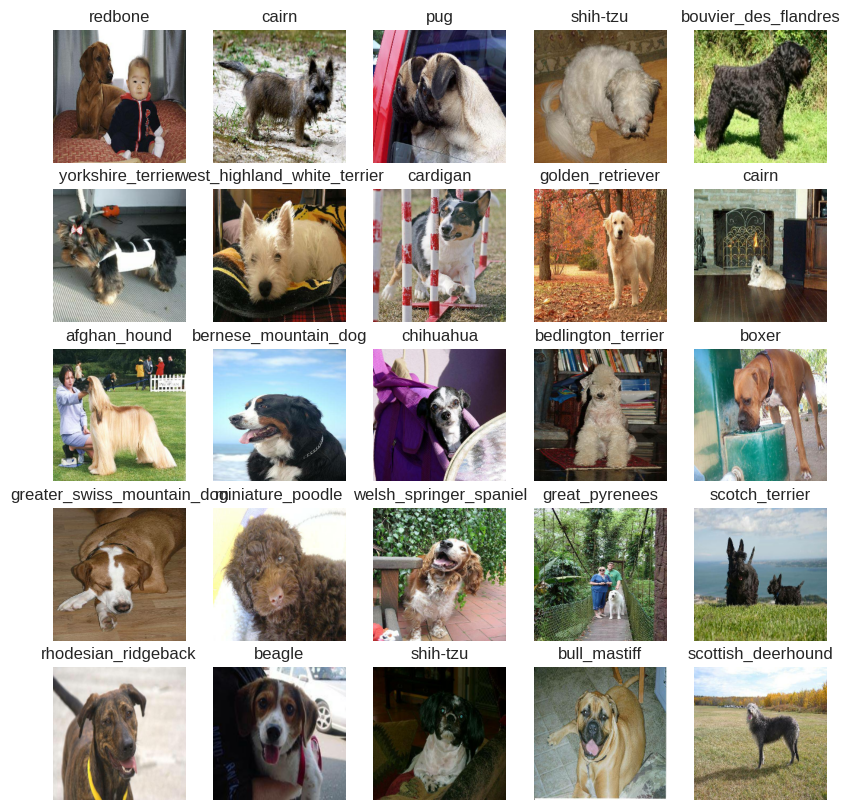

In [33]:
# Now let's visualise the data in a training batch.
show_25_images(train_images, train_labels)

In [34]:
# Now let's visualise data in a validation batch
validation_images, validation_labels = next(val_data.as_numpy_iterator())

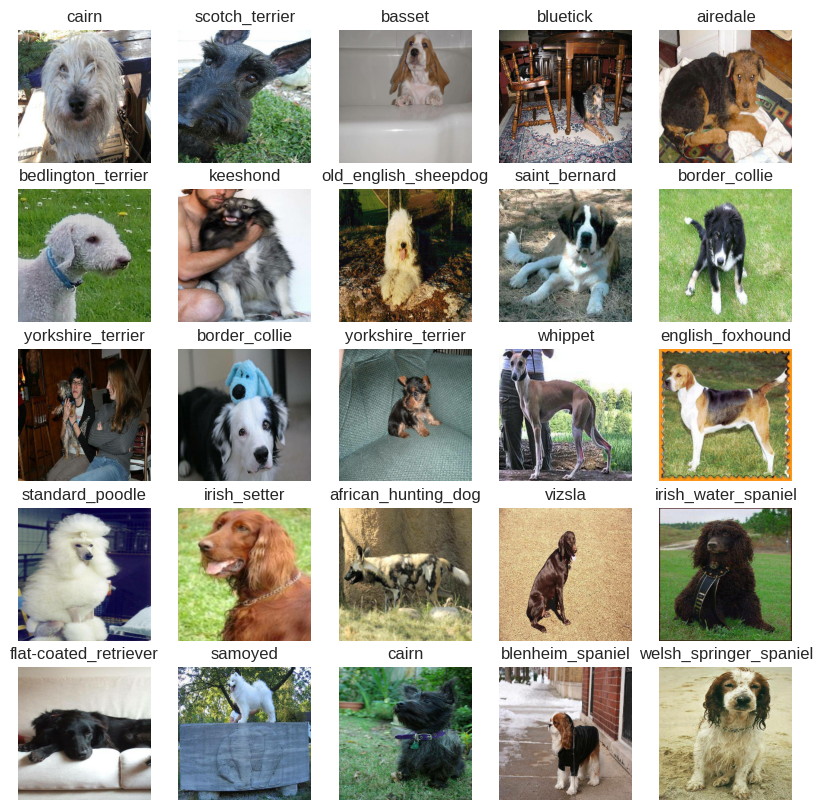

In [35]:
show_25_images(validation_images, validation_labels)

## Building a model

Before we build a model, there are a few things we need to define:

1. The input shape (our images shape, in the form of Tensors) to our model
2. The output shape (image labels in the form of Tensors) of our model.
3. The URL of the model we want to use (from TensorFlow Hub documentation).

In [36]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMAGE_SIZE, IMAGE_SIZE, 3] # batch, width, height, color-channels

# Setup output shape
OUTPUT_SHAPE = len(unique_breeds) # We want boolean array that indicate kind of dog's breed that is on the photo (our model's output)

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

Now we have got our inputs outputs and model ready to go, let's put them together inro Keras deep learning model.

Knowing this let's create a function which:
* Takes the input shape, output shape and the model we have chosen as parameters
* Defines the layers in a Keras model in a sequential fashion (do this first, then this, than that ...)
* Compiles the model (says how it should be evaluated and improved)
* Build the model (tells the model the input shape it will be getting)
* Returns the model

All of these can be found here: https://www.tensorflow.org/guide/keras/overview

In [37]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with: ", model_url)

  # Setup the model layers
  model = tf.keras.Sequential([
      hub.KerasLayer(model_url), # Layer one (input layer)
      tf.keras.layers.Dense(units=output_shape, activation="softmax") # Layer 2 (output layer)
  ])

  # Compile (opracowywać) the model
  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics = ["accuracy"]
  )

  # Build the model
  model.build(input_shape)

  return model

In [38]:
model = create_model()
model.summary()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating Callbacks

Callbacks are helper functions a model can use during training to do things such as:

* Save it's progress
* Check it's progress
* Stop training early if model stops improving

We will create two callbacks, one for TensorBoard which helps truck our model's progress and another for early stopping which prevents our model from training for too long.

### TensorBoard Callback

To setup a TensorBoard we need to do 3 things:

1. Load the `TensorBoard` notebook extension
2. Create a `TensorBoard` callback which is able to save logs to a directory and pass it to our model's `fit()` function
3. Visualise our model's training logs with a `%tensoroard` magic function (we will do this after model training)

In [39]:
# Load TensorBoard notebook extension
%load_ext tensorboard

In [40]:
import datetime

# Create a function to build a TensorFlow callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/MyDrive/DogVision/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d%H%M%S"))

  return tf.keras.callbacks.TensorBoard(logdir)

## Creating Early Stopping Callback

Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving.

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [41]:
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # As soon as it stops improving for 3 epochs we are going stop training our model

## Training a model (on subset of data)

It is always a good idea to check before training a model if we are using `GPU`.

Our first model is only going to be trained on 1000 images to make sure everything is working.

In [42]:
NUM_EPOCHS = 100 #@param {type: "slider", min: 10, max: 100, step: 10}

 > 1 epoch mean giving our model a single chance to look on all training data and then validating it from there. If we give our model 100 epochs we give him 100 chances to go through training data set and figure out the patterns. Then when we fit our model we can specify how often we want to test our model on validation set specyfing `validation_freq` when we are fitting model.

In [43]:
 # Check for GPU
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

GPU available


Let's create a function that trains a model.

* Create a model using `create_model()`
* Setup a tensorboard callback using `create_tensorboard_callback()` function
* Call the `fit()` function on our model passing it the training, validation data, number of epochs (`NUM_EPOCHS`) to train for and the callbacks we would like to use
* Return a model

In [44]:
# Build function train and return a trained model
def train_model(num_epochs=NUM_EPOCHS):
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new tensorboard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it he callbacks we created
  model.fit(x=train_data,
            epochs=num_epochs,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])

  return model

In [ ]:
# Fit the model to the data
model = train_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 309s 12s/step - loss: 4.5065 - accuracy: 0.1050 - val_loss: 3.4796 - val_accuracy: 0.2300
Epoch 2/100
25/25 [==============================] - 4s 145ms/step - loss: 1.6332 - accuracy: 0.6812 - val_loss: 2.1681 - val_accuracy: 0.5350
Epoch 3/100
25/25 [==============================] - 3s 117ms/step - loss: 0.5646 - accuracy: 0.9463 - val_loss: 1.7387 - val_accuracy: 0.5800
Epoch 4/100
25/25 [==============================] - 3s 119ms/step - loss: 0.2541 - accuracy: 0.9875 - val_loss: 1.5700 - val_accuracy: 0.6150
Epoch 5/100
25/25 [==============================] - 3s 119ms/step - loss: 0.1461 - accuracy: 0.9950 - val_loss: 1.4954 - val_accuracy: 0.6150
Epoch 6/100
25/25 [==============================] - 4s 173ms/step - loss: 0.1010 - accuracy: 0.9975 - val_loss: 1.4413 - val_accuracy: 0.6250
Epoch 7/100
25/25 [=============================

### Checking the `TensorBoard` logs

The TendorBaord magic function (`%tensorboard`) will access the logs directory we created earlier and visualise it's contents.

In [ ]:
%tensorboard --logdir drive/MyDrive/DogVision/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model

In [ ]:
# Make predictions on validation data (not used to train on)
predictions = model.predict(val_data, verbose=1) # verbose = when you making predictions show me your progress
predictions, len(predictions), predictions.shape


7/7 [==============================] - 15s 142ms/step


(array([[6.0461601e-03, 8.2843806e-05, 2.1080904e-04, ..., 1.9581294e-04,
         3.7659524e-05, 8.4263843e-04],
        [4.5756726e-03, 7.8154646e-04, 1.0902383e-02, ..., 3.7621139e-04,
         1.1151195e-02, 2.4776955e-04],
        [8.1867083e-06, 2.2829123e-05, 2.6439473e-05, ..., 3.0542156e-05,
         1.1097742e-05, 1.5821478e-03],
        ...,
        [4.9770688e-06, 1.0128636e-05, 2.0800337e-05, ..., 5.2147593e-06,
         6.3759471e-05, 9.5303476e-06],
        [3.3276447e-03, 8.3576117e-05, 7.7858356e-05, ..., 3.7962361e-04,
         1.5419653e-04, 1.6030353e-02],
        [9.4108778e-04, 1.8624005e-04, 3.6517682e-03, ..., 9.8220324e-03,
         4.0495879e-04, 3.0036087e-04]], dtype=float32),
 200,
 (200, 120))

In [ ]:
# First prediction, prediction probabilities (sometimes called confidence intervals)
index= 0
print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[index])*100:.3f}%")
print(f"Sum: {np.sum(predictions[index])}")
print(f"Max index: {np.array(predictions[0]).argmax()}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}")

[6.04616012e-03 8.28438060e-05 2.10809041e-04 3.28038004e-05
 4.00346005e-04 8.10932579e-06 2.77955662e-02 2.33600265e-04
 9.74140057e-05 8.55536782e-04 1.23247286e-04 1.81643059e-04
 1.96228211e-04 6.48049536e-05 4.95523382e-05 2.12463754e-04
 1.33079651e-04 2.20367923e-01 3.33851458e-05 4.12040863e-05
 2.53071950e-04 5.18230481e-05 5.51961894e-05 7.43652752e-04
 1.66040991e-05 1.52628098e-04 3.79174501e-01 7.99009649e-05
 2.75885424e-04 2.03763866e-05 5.06167591e-04 7.17758259e-04
 1.24132232e-04 1.09735711e-05 8.70724616e-05 9.80858691e-03
 8.57895066e-05 3.65336542e-04 4.50032239e-05 2.50931844e-05
 6.97855372e-04 1.64443372e-05 4.61540876e-05 6.64600171e-04
 1.95053526e-05 3.41316918e-04 5.12271072e-05 2.77954852e-04
 3.29708302e-04 1.62031691e-04 3.80860438e-04 7.66634093e-06
 7.79105394e-05 1.81527663e-04 2.81653745e-04 8.73772515e-05
 1.67680249e-04 9.17663565e-04 3.42087405e-05 1.37716904e-01
 1.04226405e-04 8.52533340e-05 1.49397575e-03 2.08646219e-04
 3.14487173e-04 1.859475

Having the above functionality is great but we want to be able to do it at scale.

And it would be even better if we could see the image the prediction is being made on

**Note:** Prediction probabilities are also knows as `confidence levels`

In [77]:
# Turn prediction probabilities into the respective label (easier to understand)
def get_prediction_label(prediction_probabilties):
  """
  Turns an array of prediction probabilties into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilties)]

Since our validation data is still in a batch dataset, we will have to unbatchify  it to make predictions on the validation images and then compare these predictions to validation labels (truth labels).

In [ ]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Create function that will unbatch validation batches and store results in images and labels arrays
def unbatch_data(data_batches):
  images = []
  labels = []

  # Loop through unbatched data
  for image, label in data_batches.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(label)

  return images, labels

val_images, val_labels = unbatch_data(val_data)
# val_images[0], val_labels[0]

Now we've got ways to get:

* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's make some functions to make this all a bit more visual.

We will create a function which:
* Takes an array of prediction probabilites, an array of truth labels and array of images and an integer
* Convert the prediction probabilities to a predicted label
* Plot the predicted label, it's predicted probability, the truth label and the target image on a single plot

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  true_breed = unique_breeds[np.argmax(true_label)]

  # Get the pred label
  pred_label = get_prediction_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_breed:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_breed),
                                      color=color)

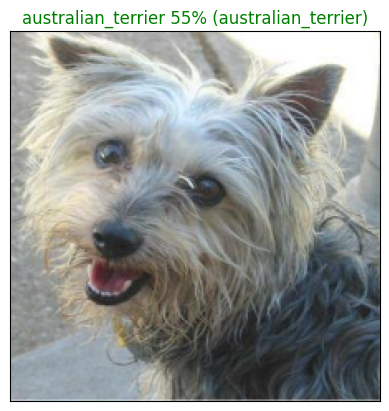

In [ ]:
plot_pred(predictions, val_labels, val_images, n=98)

Now we've got one function to visualise our model's top predictions let's make to view our model's top 10 predictions.

This function will:

* Take an input of predictions probabilities array and ground truth array and integer
* Find the predicted label using `get_pred_label`
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probability values and labels

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  true_label = unique_breeds[np.argmax(true_label)]

  # Get the predicted label
  pred_label = get_prediction_label(pred_prob)
  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

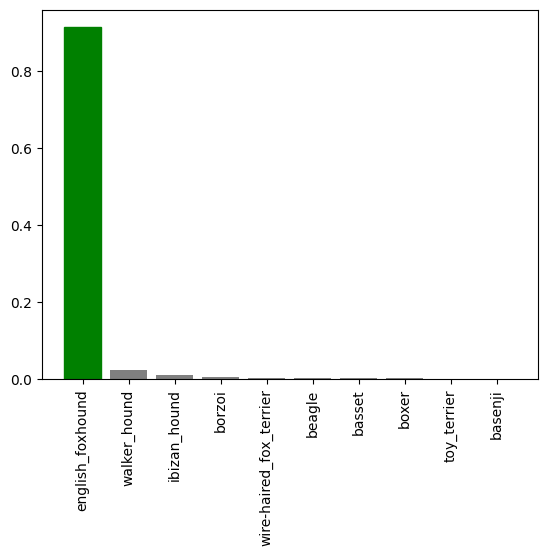

In [ ]:
plot_pred_conf(predictions, val_labels, 90)

Now we've got some function to help us visualise our predictions and evaluate our model, let's check out a few.

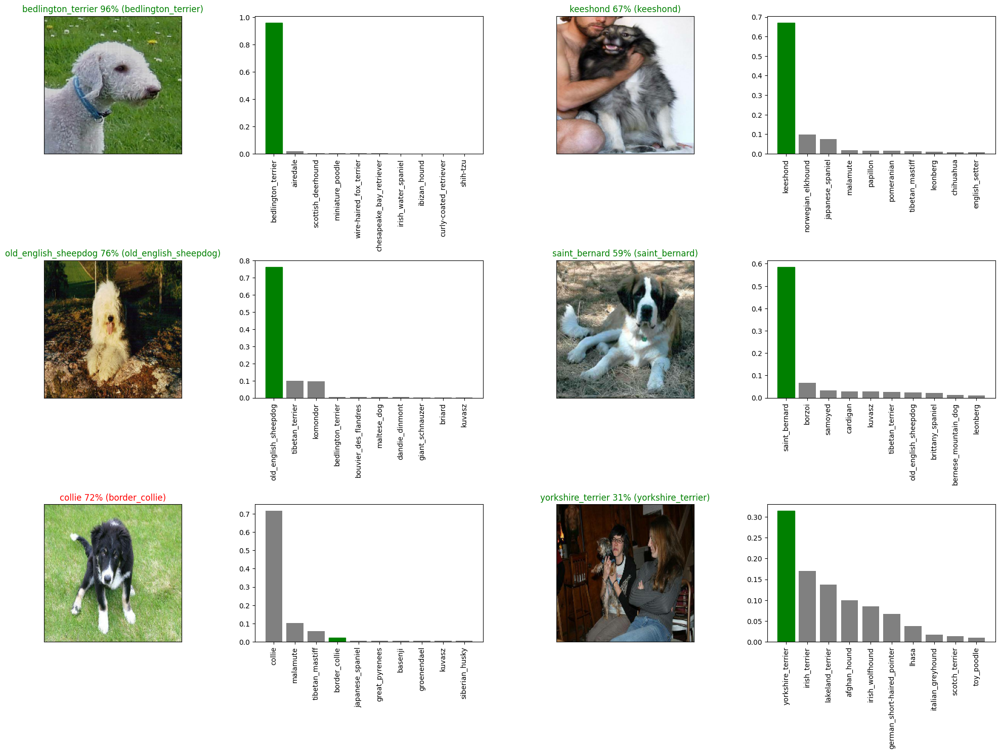

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)

  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

**Exercise:** Create a confusion matrix with our models predictions and true labels

## Saving and reloading a trained model

In [ ]:
# ! mkdir drive/MyDrive/DogVision/saved_models

In [45]:
def save_model(model, suffix=None):
  """
  Saves a given model in a model's directory and appends a suffix.
  """
  # Create a model directory pathname with current time
  model_dir = os.path.join("drive/MyDrive/DogVision/saved_models",
                           datetime.datetime.now().strftime("%Y%m%d %H:%M:%S"))
  model_path = f"{model_dir} - {suffix}.h5" # Save format of model
  print("Saving model to", model_path, "...")
  model.save(model_path)
  return model_path

In [46]:
def load_model(path_from_load):
  """
  Loads a model specified by certain path.
  """
  print("Loading model from", path_from_load, "...")
  new_model = tf.keras.models.load_model(path_from_load,
                                         custom_objects={"KerasLayer": hub.KerasLayer}) # We need to add this line when we load a model from TensorFlow Hub

  # Check its architecture
  new_model.summary()
  return new_model

Now we have got functions to save and load trained model, let's make sure they work.

In [47]:
# Save our model trained on 1000 images
# save_model(model, suffix='1000-images-mobilenetV2-Adam')

In [48]:
# Load model that was trained on 1000 images
loaded_model_1000_images = load_model("drive/MyDrive/DogVision/saved_models/20230618 07:5247 - 1000-images-mobilenetV2-Adam.h5")

Loading model from drive/MyDrive/DogVision/saved_models/20230618 07:5247 - 1000-images-mobilenetV2-Adam.h5 ...
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1001)              5432713   
                                                                 
 dense_1 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


In [49]:
model.evaluate(val_data)

7/7 [==============================] - 41s 5s/step - loss: 5.8509 - accuracy: 0.0050


[5.850937366485596, 0.004999999888241291]

In [50]:
loaded_model_1000_images.evaluate(val_data)

7/7 [==============================] - 2s 146ms/step - loss: 1.1960 - accuracy: 0.6800


[1.195970058441162, 0.6800000071525574]

## Training a big dog model (on the full data)

In [51]:
len(X), len(y)

(10222, 10222)

In [52]:
# Create a data batch with the full dataset
full_data = create_data_batches(X=X, y=y)

Creating training data batches...


In [53]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Create a model for full model
full_model = create_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [54]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all the data, so we  can't monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

**Note:** Running the cell below will take a while. It can take 30 minutes or longer for the first epoch beacuse the GPU we are using in a runtime has to load all of the images into memory.

In [ ]:
# Fit the full model to the full data
full_model.fit(x=full_data,
               verbose=1,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 2705s 8s/step - loss: 1.3163 - accuracy: 0.6720
Epoch 2/100
320/320 [==============================] - 35s 108ms/step - loss: 0.4022 - accuracy: 0.8802
Epoch 3/100
320/320 [==============================] - 36s 111ms/step - loss: 0.2327 - accuracy: 0.9371
Epoch 4/100
320/320 [==============================] - 33s 104ms/step - loss: 0.1529 - accuracy: 0.9637
Epoch 5/100
320/320 [==============================] - 34s 106ms/step - loss: 0.1063 - accuracy: 0.9771
Epoch 6/100
320/320 [==============================] - 45s 141ms/step - loss: 0.0764 - accuracy: 0.9880
Epoch 7/100
320/320 [==============================] - 47s 146ms/step - loss: 0.0600 - accuracy: 0.9907
Epoch 8/100
320/320 [==============================] - 42s 130ms/step - loss: 0.0469 - accuracy: 0.9938
Epoch 9/100
320/320 [==============================] - 50s 155ms/step - loss: 0.0372 - accuracy: 0.9965
Epoch 10/100
320/320 [==============================] - 49s 153ms

In [ ]:
save_model(full_model, "full-image-set-mobilenetV2-Adam")

Saving model to drive/MyDrive/DogVision/saved_models/20230619 12:08:32 - full-image-set-mobilenetV2-Adam.h5 ...


'drive/MyDrive/DogVision/saved_models/20230619 12:08:32 - full-image-set-mobilenetV2-Adam.h5'

In [ ]:
%tensorboard --logdir drive/MyDrive/DogVision/logs

Reusing TensorBoard on port 6006 (pid 4092), started 1:44:55 ago. (Use '!kill 4092' to kill it.)

<IPython.core.display.Javascript object>

In [55]:
loaded_full_model = load_model("/content/drive/MyDrive/DogVision/saved_models/20230619 12:08:32 - full-image-set-mobilenetV2-Adam.h5")

Loading model from /content/drive/MyDrive/DogVision/saved_models/20230619 12:08:32 - full-image-set-mobilenetV2-Adam.h5 ...
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_2 (KerasLayer)  (None, 1001)              5432713   
                                                                 
 dense_2 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Importing and making predictions using test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we will have to get it in the same format.

Luckilt wehave created `create_data_batches()` earlier which can take a list of filenames as input andconvert them into tensor batches.

To make predictions on the test data, we will:

* Get the test images filenames
* Convert filepaths into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (beacuse we don't have any labels)
* Make a predictions array passing the test batches to the `predict()` method called on our model

In [56]:
# Getting list of filenames from test dataset
test_filepaths = [f"drive/MyDrive/DogVision/test/{id}" for id in os.listdir("/content/drive/MyDrive/DogVision/test")]
test_filepaths[:10]

['drive/MyDrive/DogVision/test/e7340d1efa70bf6d6c134e1e150f9473.jpg',
 'drive/MyDrive/DogVision/test/e1ada9b155a5903bc6475255d012f681.jpg',
 'drive/MyDrive/DogVision/test/dd39ff72939c0445a76f0e7db9985f56.jpg',
 'drive/MyDrive/DogVision/test/de93f567cf5830e982182435db086b93.jpg',
 'drive/MyDrive/DogVision/test/e01b6b1e7cef1d9abdfbeb4afb88379f.jpg',
 'drive/MyDrive/DogVision/test/de85fdcf74dbe025b9b89819735cb9bc.jpg',
 'drive/MyDrive/DogVision/test/de3fbd6fb5444fcf14390ac90545c2f1.jpg',
 'drive/MyDrive/DogVision/test/e26901a9e04f0ba89765fb9b9b7f675f.jpg',
 'drive/MyDrive/DogVision/test/e25f28a6c07bf3909c4310b2685f6caf.jpg',
 'drive/MyDrive/DogVision/test/e2166bdff9e35f80aa7984ec64c8cce8.jpg']

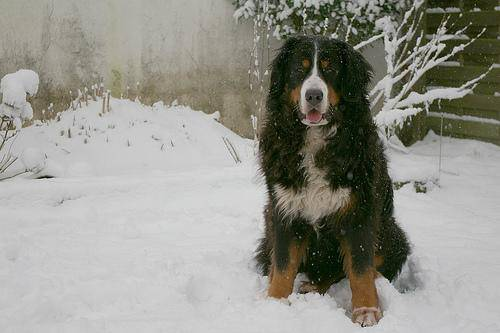

In [57]:
from IPython.display import Image

Image(test_filepaths[0])

In [58]:
test_batches = create_data_batches(test_filepaths, test_data=True)

Creating test data batches...


**Note:** calling `predict()` on our full model and passing it the test data batch will take a long time to run (about and hour).

In [ ]:
test_predictions = loaded_full_model.predict(test_batches,
                                             verbose=1)

In [ ]:
# Save our predictions to csv file
# np.savetxt("drive/MyDrive/DogVision/preds_array.csv", test_predictions, delimiter=',')

In [59]:
# Load predictions
loaded_array = np.loadtxt("drive/MyDrive/DogVision/preds_array.csv", delimiter=",")

In [60]:
sample = pd.read_csv("/content/drive/MyDrive/DogVision/sample_submission.csv")
sample.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
1,00102ee9d8eb90812350685311fe5890,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
2,0012a730dfa437f5f3613fb75efcd4ce,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
3,001510bc8570bbeee98c8d80c8a95ec1,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
4,001a5f3114548acdefa3d4da05474c2e,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333


## Prepare predictions on test data for Kaggle

In [61]:
test_predictions.shape

NameError: ignored

In [62]:
ids = [id[:len(id) - 4] for id in os.listdir("/content/drive/MyDrive/DogVision/test")]

In [63]:
def create_data_for_kaggle(predictions=test_predictions, identifiers=ids):
  breeds_dict = {breed: [] for breed in unique_breeds}

  for image_probabilities in predictions:
    for id, prob in enumerate(image_probabilities):
      breeds_dict[unique_breeds[id]].append(prob)

  own_test_data_frame = pd.DataFrame(breeds_dict)
  own_test_data_frame["id"] = identifiers
  own_test_data_frame = own_test_data_frame.set_index("id")
  return own_test_data_frame

results = create_data_for_kaggle()

NameError: ignored

In [64]:
results = results.reset_index()

NameError: ignored

In [ ]:
# Export to csv
results.to_csv("drive/MyDrive/DogVision/full_model_predictions_submission_mobilenetV2_1.csv", index=False)

## Making predictions on our own dogs

In [65]:
own_filepaths = [f"drive/MyDrive/DogVision/my_dogs/{name}" for name in os.listdir("drive/MyDrive/DogVision/my_dogs")]
own_filepaths

['drive/MyDrive/DogVision/my_dogs/received_1049479768968325.jpeg',
 'drive/MyDrive/DogVision/my_dogs/received_489083726144895.jpeg']

In [66]:
# Create batches for our own data
own_batches = create_data_batches(X=own_filepaths, test_data=True)
own_batches

Creating test data batches...


<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

Modify function to show probability and predction on our own images

In [83]:
def plot_pred_own(prediction_probabilities, images, n=0):
  """
  View the prediction and image for sample n.
  """
  plt.figure(figsize=(5, 5))

  pred_prob, image = prediction_probabilities[n], images[n]

  # Get the pred label
  pred_label = get_prediction_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.axis("off")

  plt.title(f"{pred_label} {np.max(pred_prob)*100:.2f}% probability")

In [84]:
# Create function that will unbatch our own data batches and store results in images and labels arrays
def unbatch__own_data(data_batches):
  images = []

  # Loop through unbatched data
  for image in data_batches.unbatch().as_numpy_iterator():
    images.append(image)

  return images

In [80]:
own_images = unbatch__own_data(own_batches)

In [81]:
own_predictions = loaded_full_model.predict(own_batches,
                                            verbose=1)

1/1 [==============================] - 0s 44ms/step


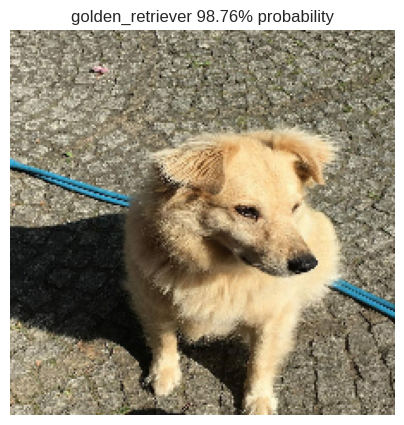

In [85]:
plot_pred_own(own_predictions, own_images)